## 프로젝트 1 : 직접 고른 이미지로 SRGAN 실험하기

In [1]:
import os
from skimage import data
import matplotlib.pyplot as plt
import cv2
import matplotlib.image as img
import tensorflow_datasets as tfds
import tensorflow as tf
import numpy as np

In [2]:
# 이미지의 특정 부분을 잘라내는 함수를 정의
def crop(image, left_top, x=200, y=200):
    return image[left_top[0]:(left_top[0]+x), left_top[1]:(left_top[1]+y), :]

In [3]:
# 이미 학습이 완료된 SRGAN모델을 불러옴.
model_file = os.getenv('HOME')+'/aiffel/super_resolution/srgan_G.h5'
srgan = tf.keras.models.load_model(model_file)

In [4]:
# 저해상도 이미지를 입력받아, SRCNN을 사용하는 함수 정의
# 이 함수를 이용하면 SRCNN의 결과로 고해상도 이미지를 얻을 수 있음.
def apply_srgan(image):
    image = tf.cast(image[np.newaxis, ...], tf.float32)
    sr = srgan.predict(image)
    sr = tf.clip_by_value(sr, 0, 255)
    sr = tf.round(sr)
    sr = tf.cast(sr, tf.uint8)
    return np.array(sr)[0]

## 프로젝트 1-1.

1. (적당히) 높은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.
2. 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 1/4로 줄입니다. cv2.resize()를 사용해 봅시다.
3. 줄인 저해상도 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.
4. 2.의 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. 마찬가지로 cv2.resize()를 사용해 봅시다.
5. 3개 이미지(4.의 Bicubic의 결과, 3.의 SRGAN의 결과, 1.의 원래 고해상도 이미지)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.
6. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)

## 1. 이미지 로드

(1080, 1920, 3)


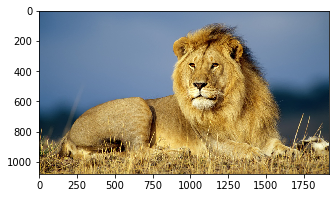

In [5]:
img_path = os.getenv('HOME')+'/aiffel/super_resolution/lion.jpg'
hr_image = img.imread(img_path)
img_shape = hr_image.shape
print(img_shape)

plt.figure(figsize=(6,3))
plt.imshow(hr_image)
#img_orig = cv2.imgread(img_path)를 사용하면 RGB와 BGR이 바뀌기 때문에 아래 코드 사용해야함.
#plt.imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))

### 2. 이미지에 bicubic interpolation을 적용해 resize

(270, 480, 3)


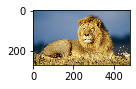

In [6]:
lr_image = cv2.resize(
    hr_image, 
    dsize=(int(hr_image.shape[1]/4), int(hr_image.shape[0]/4)), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)

print(lr_image.shape)

plt.figure(figsize=(3,1))
plt.imshow(lr_image)

### 3. 줄인 저해상도 이미지를 입력으로 SRGAN을 이용하여 고해상도 이미지를 생성

In [7]:
lr = np.array(lr_image)
hr = np.array(hr_image)
srgan_hr = apply_srgan(lr)

In [8]:
bicubic_hr = cv2.resize(
    lr, 
    dsize=(hr.shape[1], hr.shape[0]), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)

### 4. 2.의 이미지에 bicubic interpolation을 적용해 다시 4배로 늘림

(1080, 1920, 3)


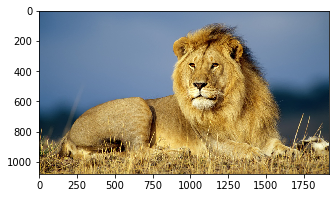

In [9]:
lr_image = cv2.resize(
    hr_image, 
    dsize=(hr_image.shape[1], hr_image.shape[0]), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)
print(lr_image.shape)

plt.figure(figsize=(6,3))
plt.imshow(lr_image)

### 5. Bicubic결과, SRGAN결과, 원래 고해상도 이미지를 나란히 시각화 함.

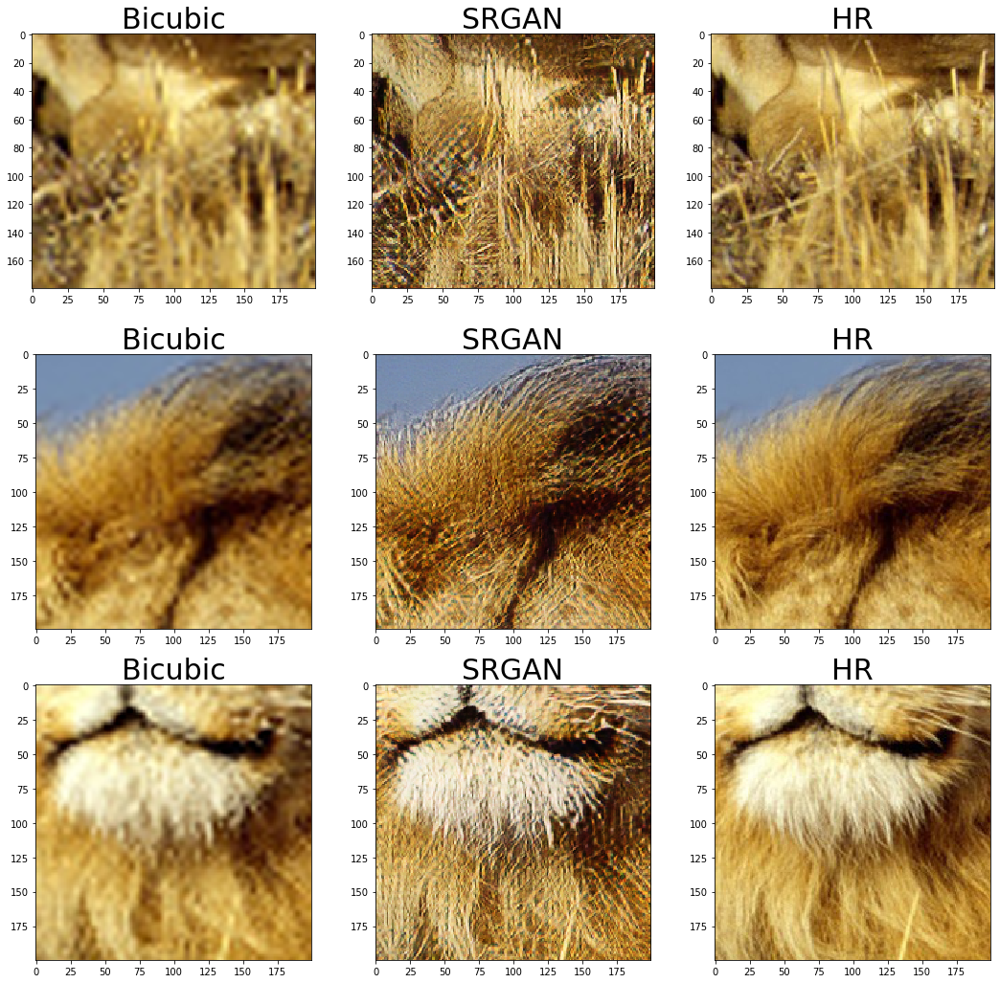

In [10]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(900,200), (90,1000), (540,1000)]

images = []
for left_top in left_tops:
    # 하단 crop되는 3개의 배열들의 shape은 모두 동일해야함.
    img1 = crop(bicubic_hr, left_top, 200, 200)
    img2 = crop(srgan_hr , left_top, 200, 200)
    img3 = crop(hr, left_top, 200, 200)
    images.extend([img1, img2, img3])
    

labels = ["Bicubic", "SRGAN", "HR"] * 3

plt.figure(figsize=(18,18))
for i in range(9):
    plt.subplot(3,3,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

### 6. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명

`Super Resolution`이란 저해상도 이미지(영상)를 고해상도 이미지(영상)로 변환하는 작업 또는 그러한 과정을 말한다. Super Resolution을 수행하는 가장 쉬운 방식은 `Interpolation`을 이용하는 것이다. Interpolation에는 선형보간법, 삼차보간법 등이 존재하고 위에서는 선형보간법을 사용하였다.<br/><br/>
tensorflow-datasets 라이브러리 중 `DIV2K` 데이터 셋을 이용하였는데, 일반적으로 자연, 동물, 건물 등의 이미지가 학습에 사용되었다. 따라서 input값으로 넣은 사자에서도 꽤 좋은 결과가 나온 것을 볼 수 있다.
학습에 이용되지 않은 이미지가 input으로 들어갔다면, 위와 같이 좋은 결과를 얻지 못했을 것이다.

## 프로젝트 1-2.
1. (적당히) 낮은 해상도를 가진 이미지를 검색해서 한 장 고른 후 저장하고 불러옵니다.
2. 불러온 이미지를 입력으로 SRGAN을 이용해 고해상도 이미지를 생성합니다. 이전에 사용한 apply_srgan 함수를 사용하면 쉽습니다.
3. 1.에서 불러온 이미지에 bicubic interpolation을 적용해 가로 및 세로 픽셀 수를 다시 4배로 늘립니다. cv2.resize()를 사용해 봅시다.
4. 2개 이미지(3.의 Bicubic의 결과, 2.의 SRGAN의 결과)를 나란히 시각화합니다. 각 이미지의 제목에 어떤 방법에 대한 결과인지 표시해 주세요. 이전 시각화에 사용했던 코드를 참고하면 어렵지 않습니다.
5. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명해 봅시다. (정답은 없습니다)

### 1. 이미지 로드

(270, 480, 3)


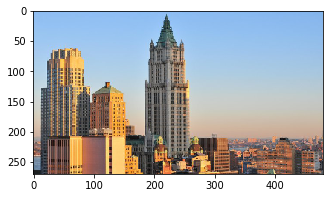

In [11]:
img_path = os.getenv('HOME')+'/aiffel/super_resolution/buliding3.jpg'
hr_image = img.imread(img_path)
hr_image = cv2.resize(hr_image, dsize=(480,270))

img_shape = hr_image.shape
print(img_shape)

plt.figure(figsize=(6,3))

plt.imshow(hr_image)
#img_orig = cv2.imgread(img_path)를 사용하면 RGB와 BGR이 바뀌기 때문에 아래 코드 사용해야함.
#plt.imshow(cv2.cvtColor(img_orig, cv2.COLOR_BGR2RGB))

### 2. 불러온 이미지를 입력으로 SRGAN을 이용하여 고해상도 이미지를 생성

(1080, 1920, 3)


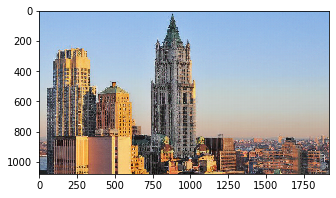

In [12]:
srgan_hr = apply_srgan(hr_image)

print(srgan_hr.shape)
plt.figure(figsize=(6,3))
plt.imshow(srgan_hr)

### 3. 1.에서 불러온 이미지에 bicubic interpolation을 적용해 resize

(1080, 1920, 3)


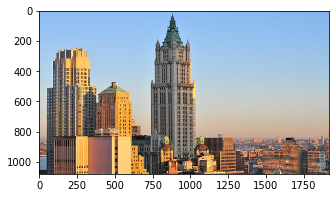

In [13]:
bicubic_hr = cv2.resize(
    hr_image, 
    dsize=(int(hr_image.shape[1]*4), int(hr_image.shape[0]*4)), # 고해상도 이미지 크기로 설정
    interpolation=cv2.INTER_CUBIC # bicubic 설정
)
print(bicubic_hr.shape)

plt.figure(figsize=(6,3))
plt.imshow(bicubic_hr)

### 4. Bicubic결과, SRGAN결과 이미지를 나란히 시각화 함.

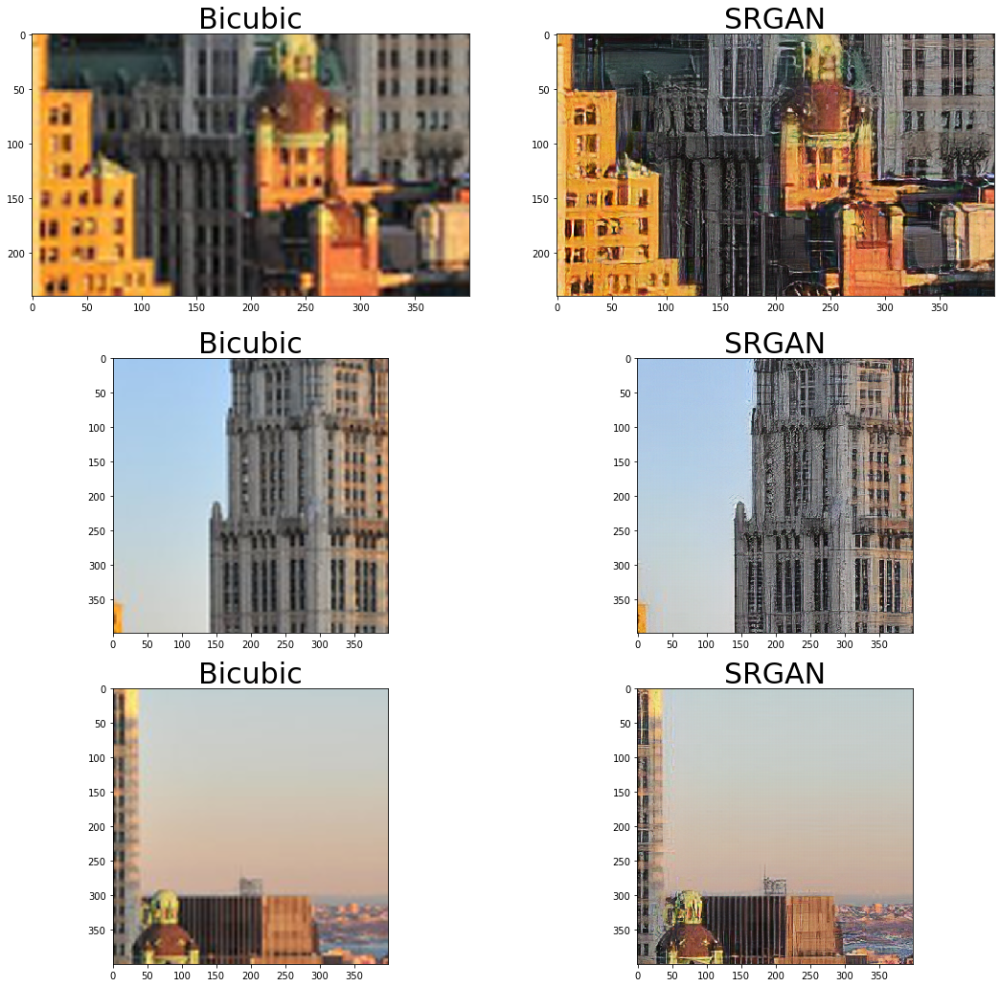

In [14]:
# 자세히 시각화 하기 위해 3개 영역을 잘라냅니다.
# 아래는 잘라낸 부분의 좌상단 좌표 3개 입니다.
left_tops = [(840,600), (250,600), (540,1000)]

images = []
for left_top in left_tops:
    img1 = crop(bicubic_hr, left_top, 400, 400)
    img2 = crop(srgan_hr , left_top, 400, 400)
    #img3 = crop(lr_image, left_top, 400, 400)
    images.extend([img1, img2])

labels = ["Bicubic", "SRGAN"] * 3

plt.figure(figsize=(18,18))
for i in range(6):
    plt.subplot(3,2,i+1) 
    plt.imshow(images[i])
    plt.title(labels[i], fontsize=30)

### 5. 선택한 이미지를 DIV2K 데이터셋에서 학습된 모델로 Super Resolution했을 때 어떠한 결과가 나왔으며, 왜 이러한 결과가 출력되었는지 설명

앞선 1-1프로젝트에서 언급했듯이 DIV2K 데이터셋은 건물 이미지가 학습에 사용되었다.<br/>
그렇기 때문에 1-2프로젝트에서 input으로 넣은 건물 이미지또한 잘 Resolution하는 것을 볼 수 있다. 

## 프로젝트 2 : SRGAN을 이용해 고해상도 gif 생성하기

### 1. git 파일 불러오기

In [15]:
# 다운받은 파일의 경로를 설정해 주세요.
img_path = os.getenv('HOME')+'/aiffel/super_resolution/city_night_lr.gif'
gif = cv2.VideoCapture(img_path)

isTrue = True
frames = []
while isTrue:
    isTrue, frame = gif.read()
    if isTrue:
        frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
        frames.append(frame)

print("frame 수 :", len(frames))
print("frame 크기 :", (frames[0].shape))

frame 수 : 8
frame 크기 : (255, 500, 3)


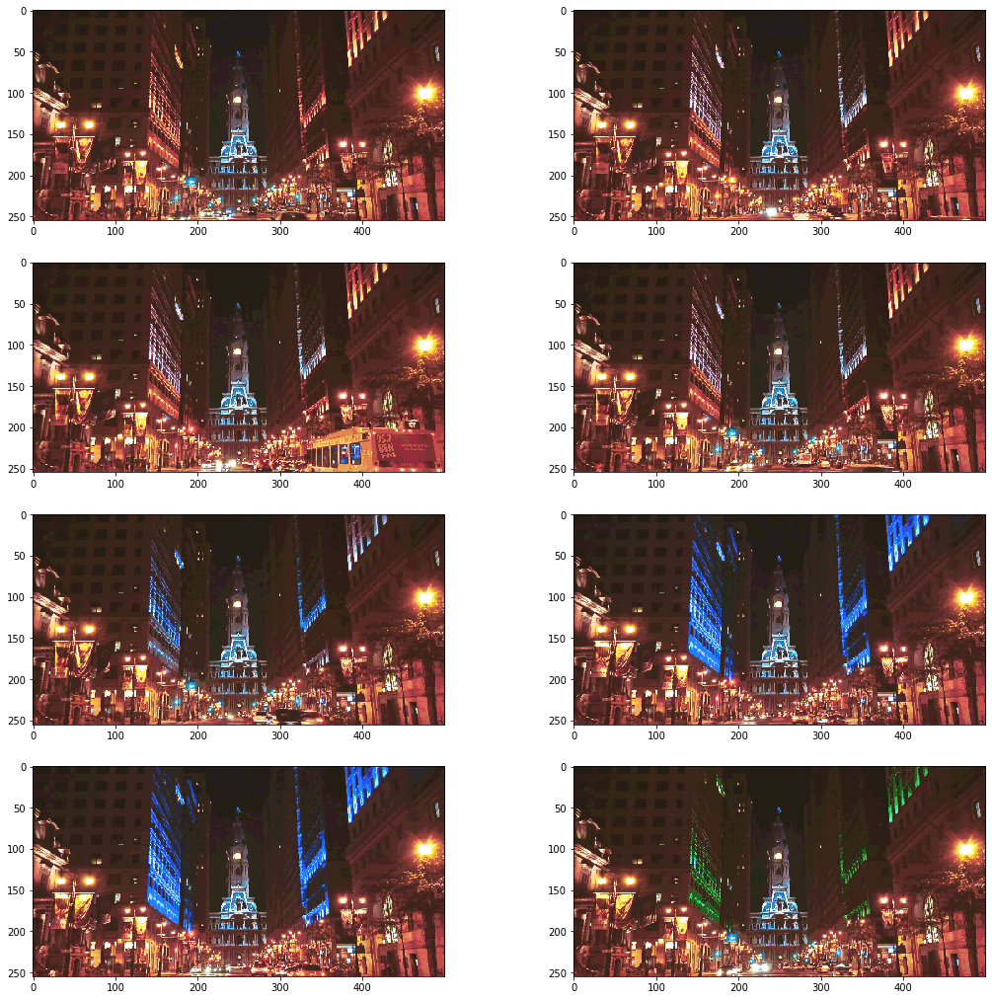

In [16]:
# 원본 gif의 frame을 확인하기 위한 코드
plt.figure(figsize=(18,18))
for i in range(len(frames)):
    plt.subplot(4,2,i+1) 
    plt.imshow(frames[i])

### 2. 프레임별 Super Resolution 진행하기
- Bicubic interpolation 과 SRGAN을 이용해 각각의 가로, 세로 픽셀 수를 4배로 늘리기
- Super Resolution이 완료된 각각의 결과를 frames_sr이라는 리스트에 넣기

In [17]:
frames_bicubic = []
frames_srgan = []

for i in range(len(frames)):
    bicubic_hr2 = cv2.resize(
        frames[i], 
        dsize=(2000,1020), # 고해상도 이미지 크기로 설정
        interpolation=cv2.INTER_CUBIC # bicubic 설정
    )
    frames_bicubic.append(bicubic_hr2)
    
    srgan_hr = apply_srgan(frames[i])
    frames_srgan.append(srgan_hr)


print("frame 수 :", np.shape(frames_bicubic))
print("frame 크기 :", np.shape(frames_srgan))

frame 수 : (8, 1020, 2000, 3)
frame 크기 : (8, 1020, 2000, 3)


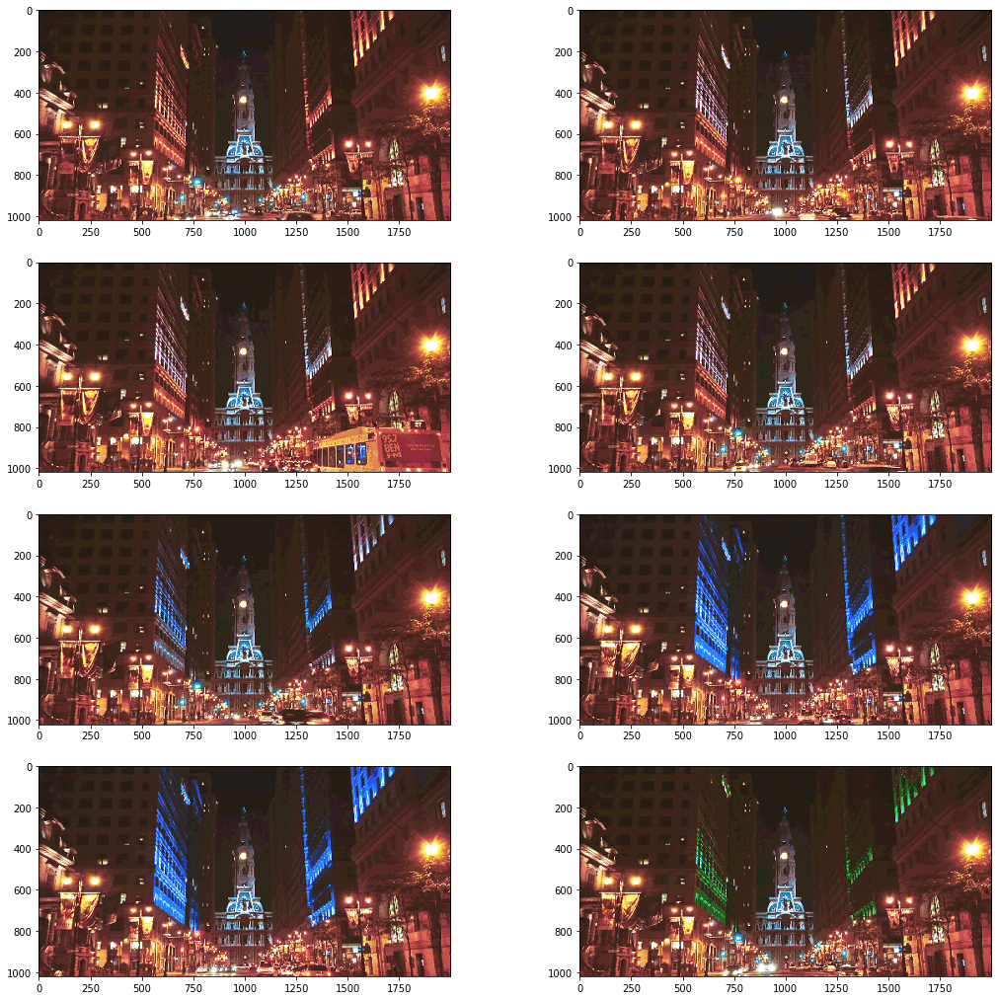

In [18]:
# bicubic의 frame을 확인하기 위한 코드
plt.figure(figsize=(18,18))
for i in range(len(frames)):
    plt.subplot(4,2,i+1) 
    plt.imshow(frames_bicubic[i])

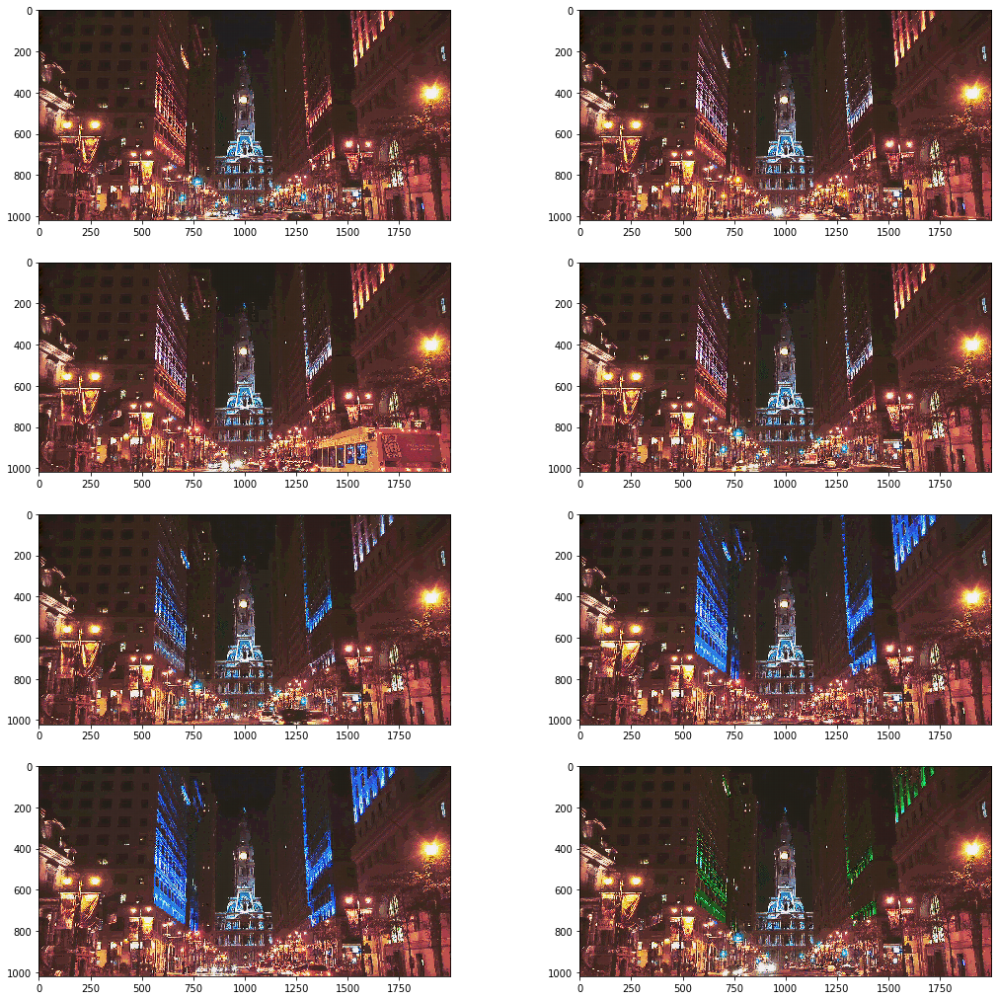

In [19]:
# srgan의 frame을 확인하기 위한 코드
plt.figure(figsize=(18,18))
for i in range(len(frames)):
    plt.subplot(4,2,i+1) 
    plt.imshow(frames_srgan[i])

In [20]:
frames_sr = frames_bicubic
frames_sr.append(frames_srgan)
print(np.shape(frames_sr))

(9,)


### 3. 프레임을 합쳐 gif 만들기

In [21]:
import imageio

imageio.mimsave("고해상도.gif", frames_srgan)

### 4. gif 표시하기
- 저해상도 및 고해상도 시각화의 width 값은 같도록 설정

#### < 저해상도 이미지 >

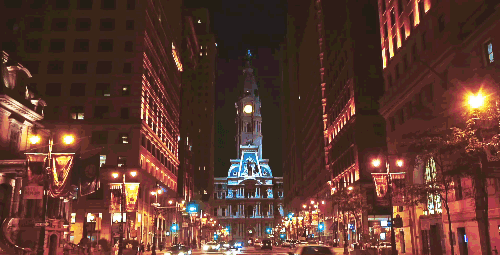

In [22]:
# 아래와 같이 호출해도 됨.
from IPython.display import Image as show_gif

show_gif("저해상도.gif", width=800) # 원본 git

#### < 고해상도 이미지 >

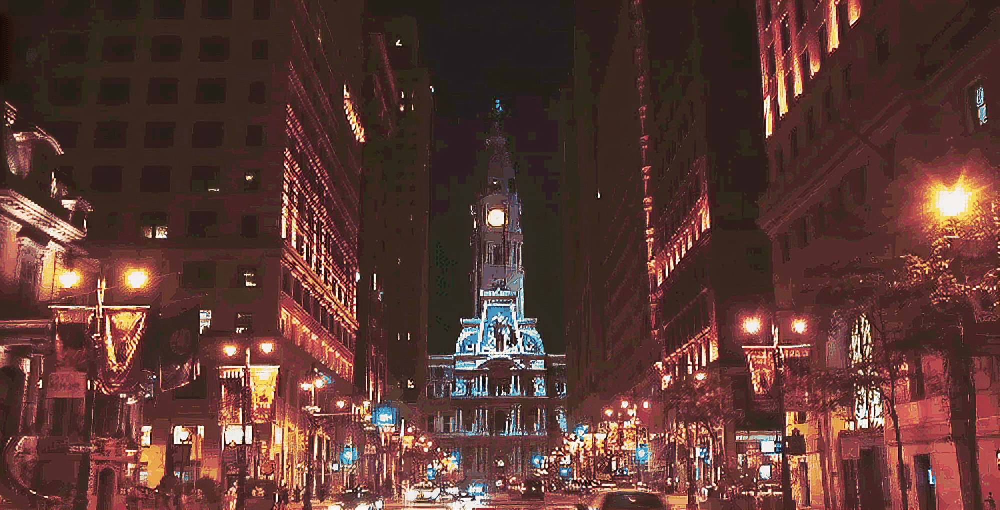

In [23]:
show_gif("고해상도.gif", width=800) # 위에서 설정한 width와 같은 값으로 설정해주세요